In [3]:
import astropy.constants as c
import glob
from hciplot import plot_frames, plot_cubes
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd

#from special.model_resampling import resample_model
#from special.utils_spec import find_nearest

from vip_hci.config import VLT_SPHERE_IFS
from vip_hci.fits import open_fits, write_fits, info_fits
from vip_hci.fm import (cube_inject_companions, firstguess, mcmc_negfc_sampling, normalize_psf,
                        show_walk_plot, show_corner_plot, confidence)
from vip_hci.metrics import snr, significance
from vip_hci.psfsub import median_sub, pca, pca_annular, pca_annulus, pca_grid
from vip_hci.preproc import find_scal_vector, frame_rescaling
from vip_hci.var import frame_center, dist, mask_circle

## Loading and visualizing the data

In [4]:
# Let’s first inspect the fits file
info_fits('/home/cvargas/sphere/IFS/SPHERE_DC_DATA_AS209_IFS/HIP-82323_OBS_H_2021-04-06_ifs_convert_dc2_PUBLIC_305341/ifs_convert_dc2-IFS_SCIENCE_REDUCED_SPECTRAL_MASTER_CUBE-center_im.fits')

Filename: /home/cvargas/sphere/IFS/SPHERE_DC_DATA_AS209_IFS/HIP-82323_OBS_H_2021-04-06_ifs_convert_dc2_PUBLIC_305341/ifs_convert_dc2-IFS_SCIENCE_REDUCED_SPECTRAL_MASTER_CUBE-center_im.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  SCIDATA       1 PrimaryHDU    1364   (290, 290, 32, 39)   float32   


In [5]:
cubename = '/home/cvargas/sphere/IFS/SPHERE_DC_DATA_AS209_IFS/HIP-82323_OBS_H_2021-04-06_ifs_convert_dc2_PUBLIC_305341/ifs_convert_dc2-IFS_SCIENCE_REDUCED_SPECTRAL_MASTER_CUBE-center_im.fits'
psfname = '/home/cvargas/sphere/IFS/SPHERE_DC_DATA_AS209_IFS/HIP-82323_OBS_H_2021-04-06_ifs_convert_dc2_PUBLIC_305341/ifs_convert_dc2-IFS_SCIENCE_PSF_MASTER_CUBE-median_unsat.fits'
lbdaname = '/home/cvargas/sphere/IFS/SPHERE_DC_DATA_AS209_IFS/HIP-82323_OBS_H_2021-04-06_ifs_convert_dc2_PUBLIC_305341/ifs_convert_dc2-IFS_SCIENCE_LAMBDA_INFO-lam.fits'
anglename = '/home/cvargas/sphere/IFS/SPHERE_DC_DATA_AS209_IFS/HIP-82323_OBS_H_2021-04-06_ifs_convert_dc2_PUBLIC_305341/ifs_convert_dc2-IFS_SCIENCE_PARA_ROTATION_CUBE-rotnth.fits'

cube = open_fits(cubename)
psf = open_fits(psfname)
lbda = open_fits(lbdaname)
derot_angles = -1*open_fits(anglename) # note: SPHERE DRH returns parallactic angles, while VIP routines take derotation angles as input

nch, nz, ny, nx = cube.shape

Fits HDU-0 data successfully loaded. Data shape: (39, 32, 290, 290)
Fits HDU-0 data successfully loaded. Data shape: (39, 5, 64, 64)
Fits HDU-0 data successfully loaded. Data shape: (39,)
Fits HDU-0 data successfully loaded. Data shape: (32,)


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time,lambda]   (flux)
:Cube_shape	[290, 290, 32, 39]


:DynamicMap   [time,lambda]
   :Image   [x,y]   (flux)
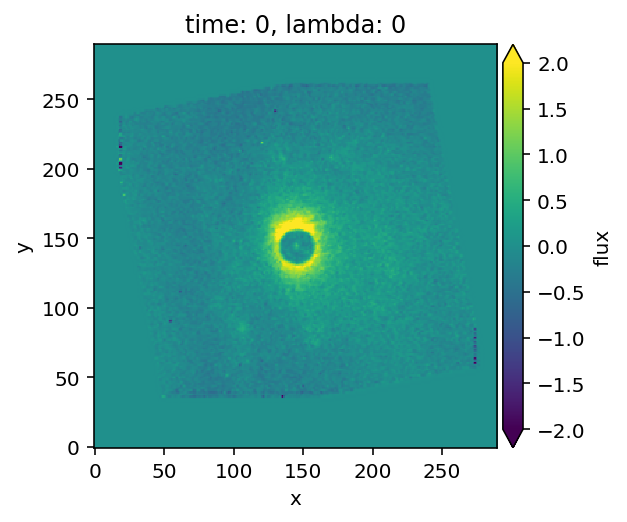

In [6]:
plot_cubes(cube, vmin=-2, vmax=2)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time,lambda]   (flux)
:Cube_shape	[64, 64, 5, 39]


:DynamicMap   [time,lambda]
   :Image   [x,y]   (flux)
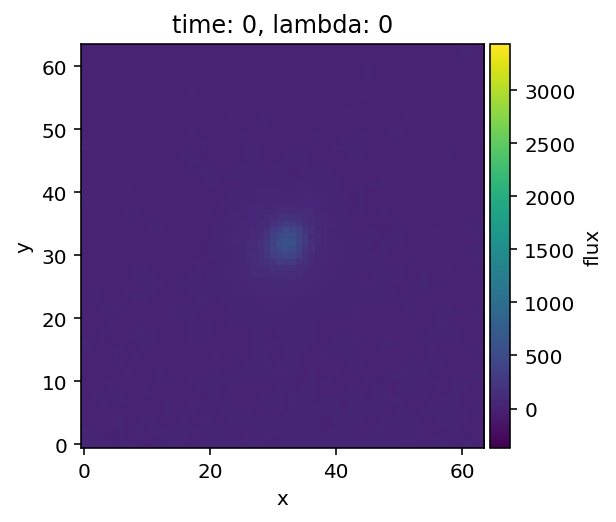

In [16]:
plot_cubes(psf)

Text(0, 0.5, 'Parallactic angle (deg)')

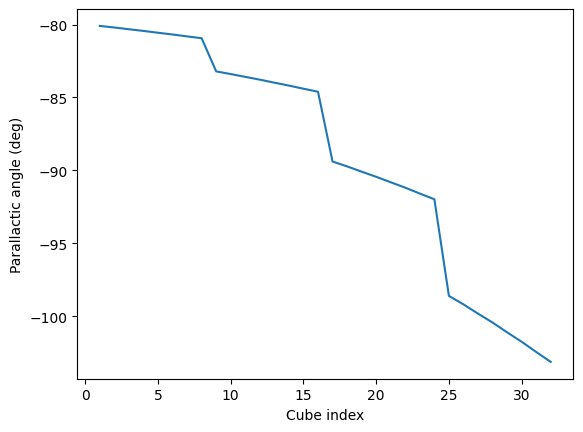

In [11]:
%matplotlib inline
fig, axes = plt.subplots(1)
ax1 = axes
ax1.plot(range(1,nz+1), derot_angles)
ax1.set_xlabel("Cube index")
ax1.set_ylabel("Parallactic angle (deg)")

In [12]:
plsc = VLT_SPHERE_IFS['plsc']
print(plsc, "arcsec/px")

0.00746 arcsec/px


## Flux normalization

### Non-coronagraphic PSF normalization

`Force_odd` is True and frame size is even, therefore new frame size was set to 63


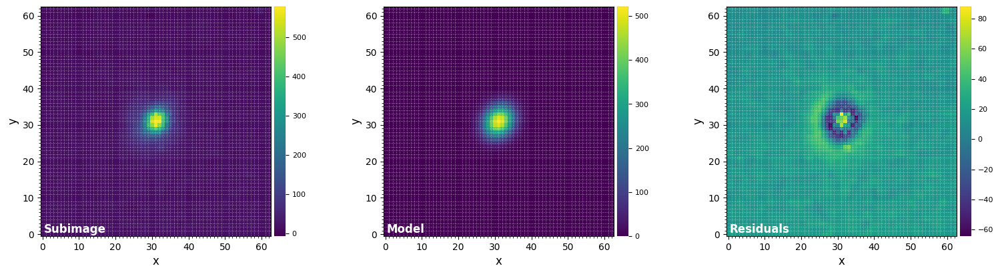

FWHM_y = 7.39983807191283
FWHM_x = 6.228649875630969 

centroid y = 30.994861326257634
centroid x = 31.036847039144895
centroid y subim = 30.994861326257634
centroid x subim = 31.036847039144895 

amplitude = 521.7056078537146
theta = -34.36741338968536


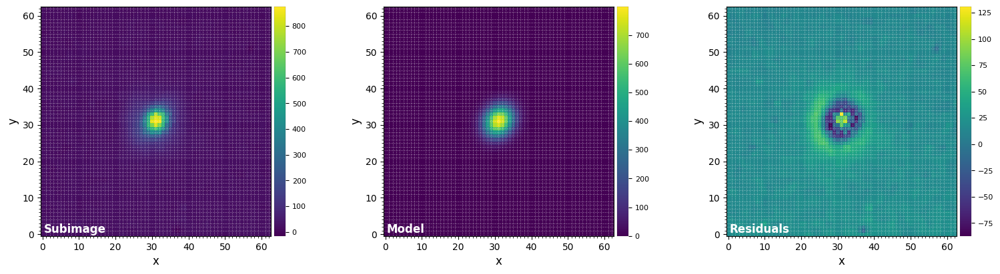

FWHM_y = 7.193987277772525
FWHM_x = 6.053288306396135 

centroid y = 31.09779574303357
centroid x = 31.02701182352686
centroid y subim = 31.09779574303357
centroid x subim = 31.02701182352686 

amplitude = 799.7960415057028
theta = -34.15881429059018


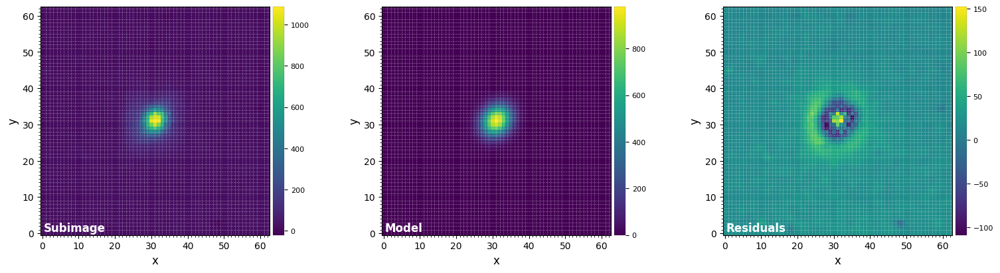

FWHM_y = 7.172350206544576
FWHM_x = 6.04792665512059 

centroid y = 31.115766974547203
centroid x = 31.02059185418863
centroid y subim = 31.115766974547203
centroid x subim = 31.02059185418863 

amplitude = 980.5925483360253
theta = -36.42740878639825


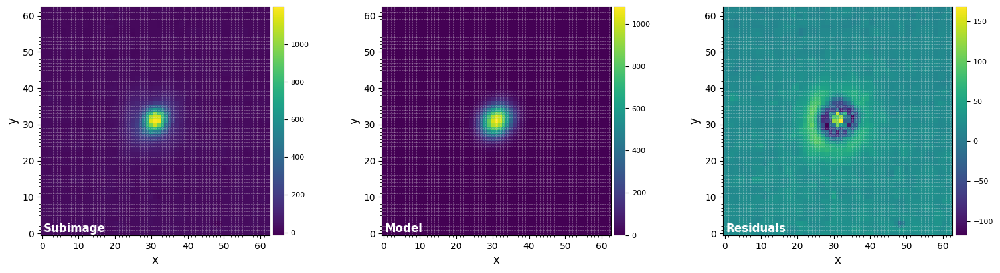

FWHM_y = 7.140184005672778
FWHM_x = 6.0355534412045335 

centroid y = 31.114829260699146
centroid x = 31.013509017539626
centroid y subim = 31.114829260699146
centroid x subim = 31.013509017539626 

amplitude = 1082.719636693006
theta = -37.902366842934214


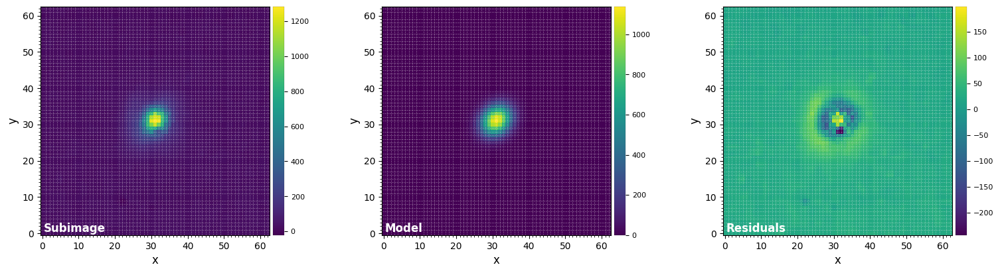

FWHM_y = 7.226331854215675
FWHM_x = 5.9958751587940045 

centroid y = 31.191592487089235
centroid x = 30.977758171672814
centroid y subim = 31.191592487089235
centroid x subim = 30.977758171672814 

amplitude = 1141.690323539367
theta = -43.30201126273823


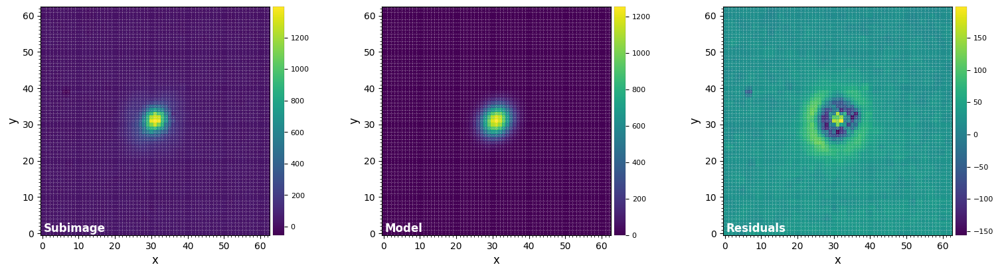

FWHM_y = 7.1408971689083
FWHM_x = 6.0962633309357654 

centroid y = 31.12022626727161
centroid x = 30.95641334752795
centroid y subim = 31.12022626727161
centroid x subim = 30.95641334752795 

amplitude = 1256.8754362189613
theta = -37.993838245386456


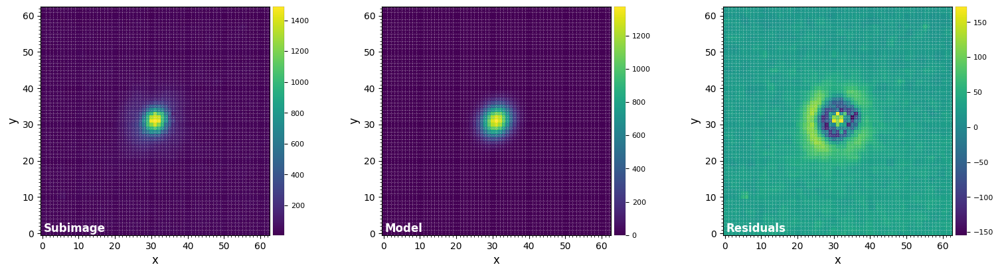

FWHM_y = 7.129307724148852
FWHM_x = 6.131499455267095 

centroid y = 31.05764456747458
centroid x = 30.975973543264164
centroid y subim = 31.05764456747458
centroid x subim = 30.975973543264164 

amplitude = 1374.8442673879101
theta = -34.582757797185415


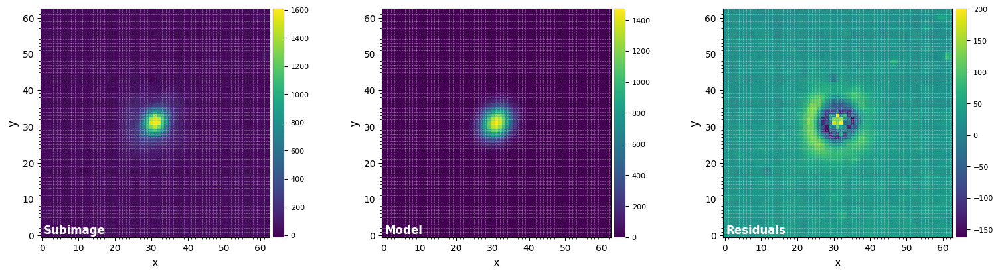

FWHM_y = 7.252397367895199
FWHM_x = 6.135781635140763 

centroid y = 31.07970041826681
centroid x = 30.99659161887006
centroid y subim = 31.07970041826681
centroid x subim = 30.99659161887006 

amplitude = 1473.37082760212
theta = -36.47833759246675


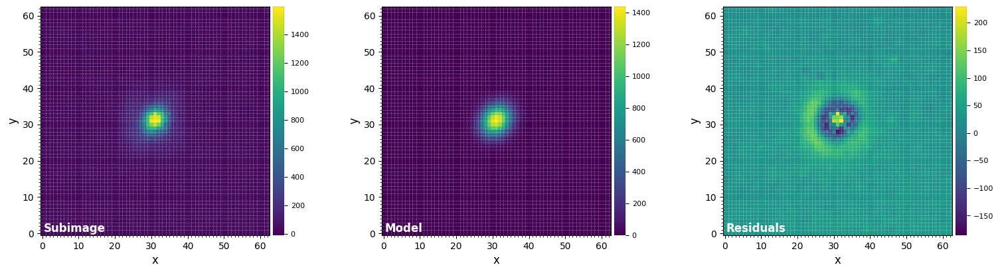

FWHM_y = 7.312265258966033
FWHM_x = 6.131159695926625 

centroid y = 31.186911200659644
centroid x = 30.954240181392887
centroid y subim = 31.186911200659644
centroid x subim = 30.954240181392887 

amplitude = 1441.9012477033548
theta = -37.491252471725


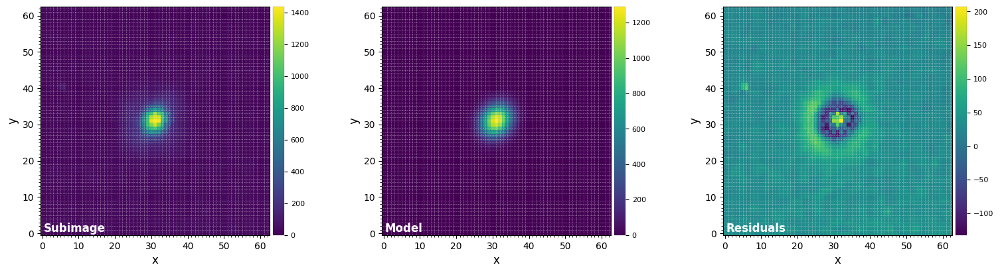

FWHM_y = 7.393918915397831
FWHM_x = 6.213156854618082 

centroid y = 31.140489364759897
centroid x = 30.974474792415766
centroid y subim = 31.140489364759897
centroid x subim = 30.974474792415766 

amplitude = 1293.0156067232795
theta = -33.74936912567803


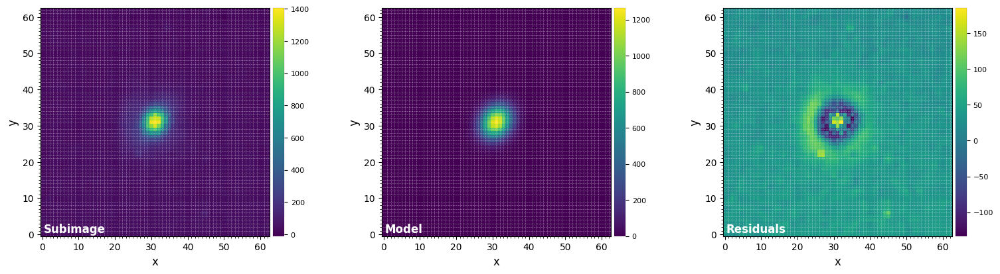

FWHM_y = 7.5280741711669545
FWHM_x = 6.293058597624336 

centroid y = 31.071239192103093
centroid x = 30.954868835829533
centroid y subim = 31.071239192103093
centroid x subim = 30.954868835829533 

amplitude = 1266.038452684691
theta = -32.706348440129055


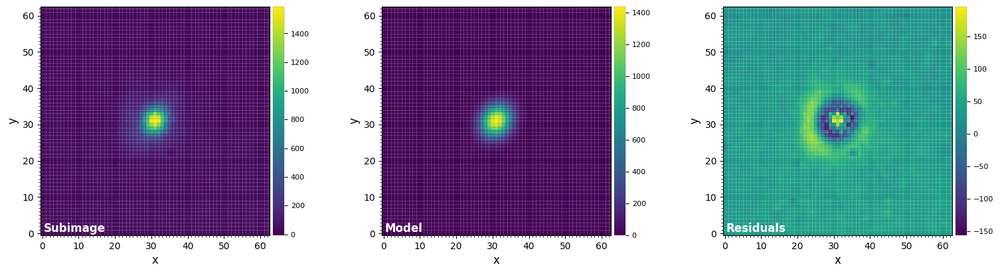

FWHM_y = 7.481117326104908
FWHM_x = 6.318793848040137 

centroid y = 31.04816362817958
centroid x = 30.943808091997695
centroid y subim = 31.04816362817958
centroid x subim = 30.943808091997695 

amplitude = 1440.010228052824
theta = -32.980704289730355


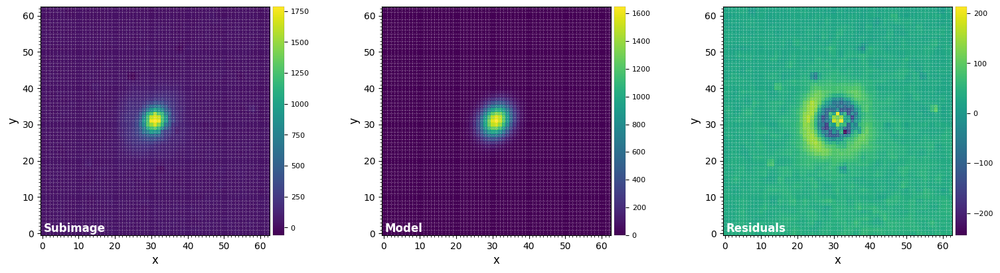

FWHM_y = 7.4982261397496215
FWHM_x = 6.146935264687436 

centroid y = 31.119979299360292
centroid x = 30.89727813951396
centroid y subim = 31.119979299360292
centroid x subim = 30.89727813951396 

amplitude = 1653.1047931959788
theta = -33.23620362393962


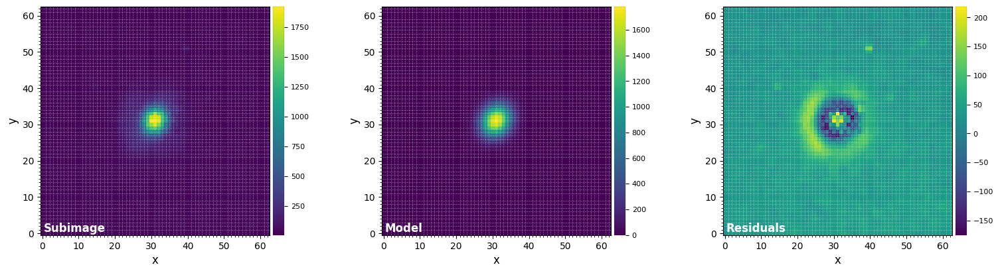

FWHM_y = 7.435936647573235
FWHM_x = 6.283550459124418 

centroid y = 31.07566855238517
centroid x = 30.91610904112524
centroid y subim = 31.07566855238517
centroid x subim = 30.91610904112524 

amplitude = 1783.6322559565272
theta = -31.03684787444124


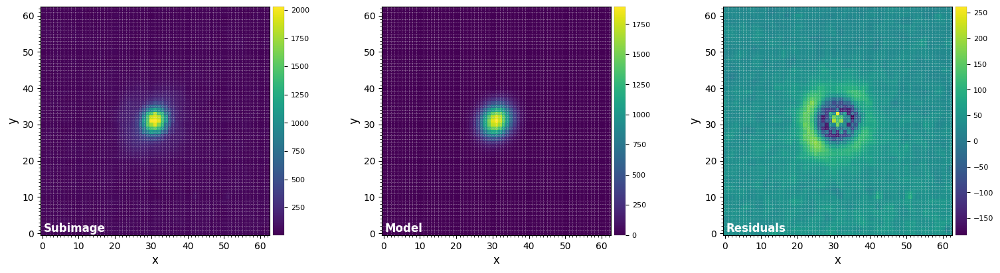

FWHM_y = 7.391914238391301
FWHM_x = 6.338414580685629 

centroid y = 31.068133633024736
centroid x = 30.894437698896205
centroid y subim = 31.068133633024736
centroid x subim = 30.894437698896205 

amplitude = 1898.4456402919432
theta = -31.575954585921277


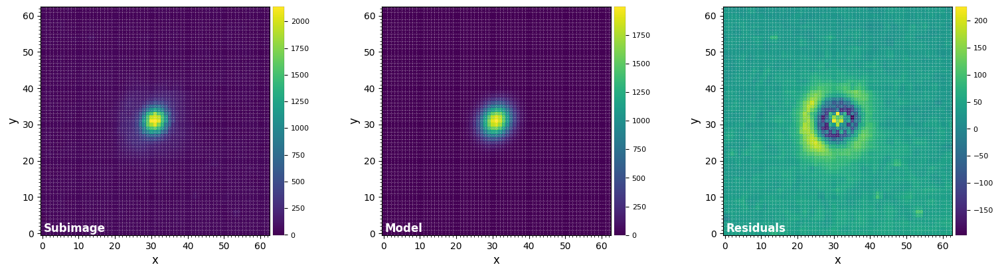

FWHM_y = 7.432064024910463
FWHM_x = 6.336210259189358 

centroid y = 31.062022553390786
centroid x = 30.878338913525837
centroid y subim = 31.062022553390786
centroid x subim = 30.878338913525837 

amplitude = 2000.796127148853
theta = -31.950627711269018


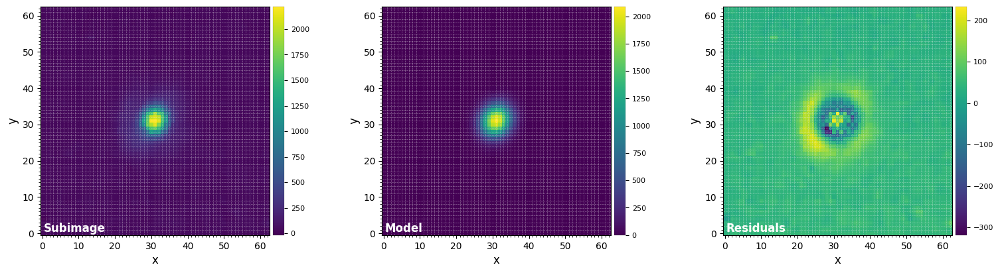

FWHM_y = 7.313832732192303
FWHM_x = 6.376936592582208 

centroid y = 31.103146799481607
centroid x = 30.91208133551516
centroid y subim = 31.103146799481607
centroid x subim = 30.91208133551516 

amplitude = 2091.9767220553636
theta = -29.310092785314183


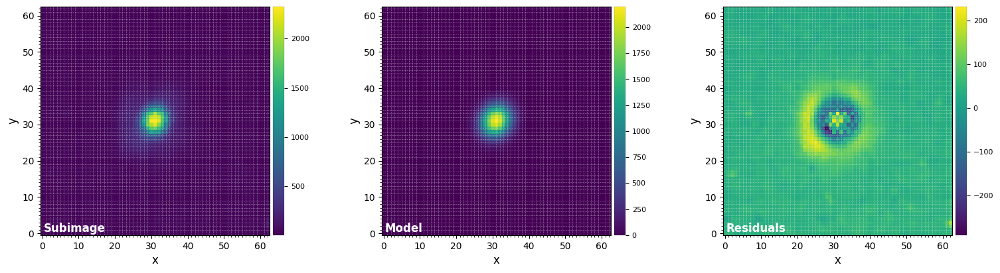

FWHM_y = 7.340798838279314
FWHM_x = 6.417276389659099 

centroid y = 31.078523020593458
centroid x = 30.89612996717053
centroid y subim = 31.078523020593458
centroid x subim = 30.89612996717053 

amplitude = 2201.0931577444762
theta = -29.24541677590878


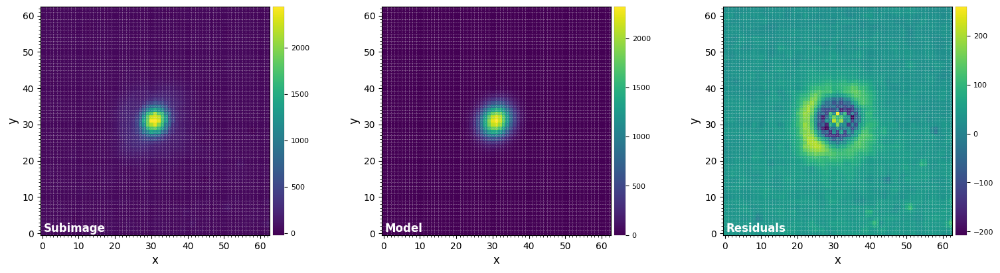

FWHM_y = 7.398793217938977
FWHM_x = 6.421719027298298 

centroid y = 31.081590337379584
centroid x = 30.853466567112235
centroid y subim = 31.081590337379584
centroid x subim = 30.853466567112235 

amplitude = 2326.542588151853
theta = -31.71552048776671


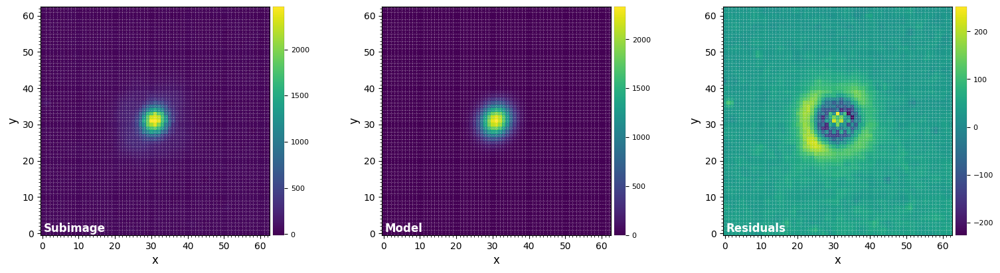

FWHM_y = 7.360138354394609
FWHM_x = 6.424436845442458 

centroid y = 31.097794968790396
centroid x = 30.826563449818305
centroid y subim = 31.097794968790396
centroid x subim = 30.826563449818305 

amplitude = 2341.803670693478
theta = -29.998364938344963


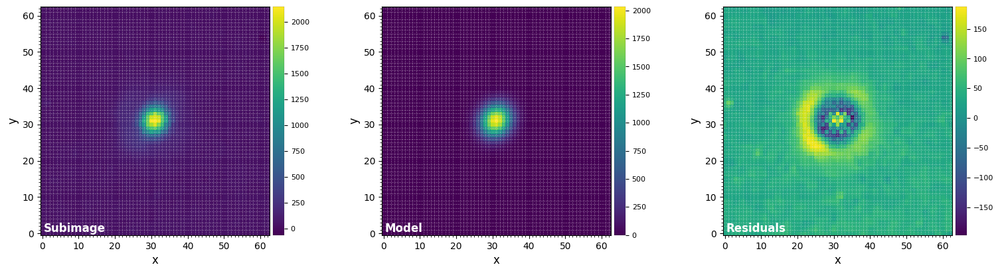

FWHM_y = 7.404154031390941
FWHM_x = 6.5191723568186335 

centroid y = 31.13738022872905
centroid x = 30.859502807070367
centroid y subim = 31.13738022872905
centroid x subim = 30.859502807070367 

amplitude = 2039.502616963034
theta = -32.38654537507023


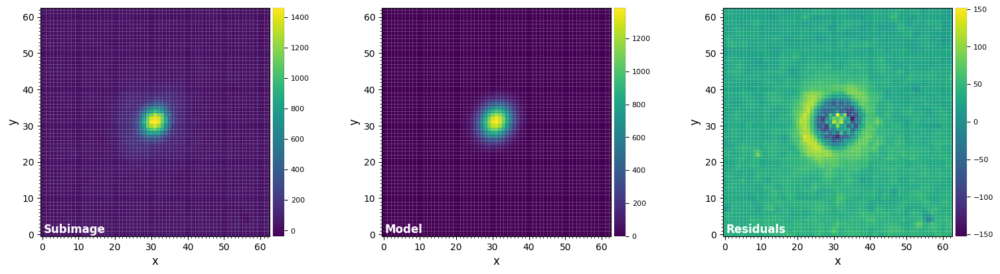

FWHM_y = 7.688832186581474
FWHM_x = 6.6875260390385245 

centroid y = 31.203755072065544
centroid x = 30.86478148314713
centroid y subim = 31.203755072065544
centroid x subim = 30.86478148314713 

amplitude = 1390.8687474122469
theta = -33.99288263690325


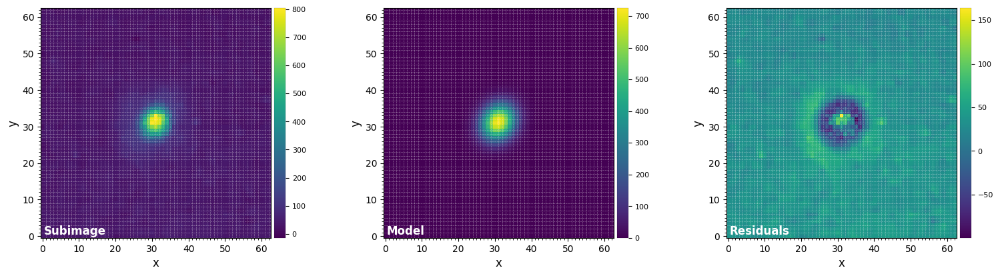

FWHM_y = 8.346769576033694
FWHM_x = 7.165300358333211 

centroid y = 31.272957918779998
centroid x = 30.88263245866669
centroid y subim = 31.272957918779998
centroid x subim = 30.88263245866669 

amplitude = 728.6460765616899
theta = -32.77351338491609


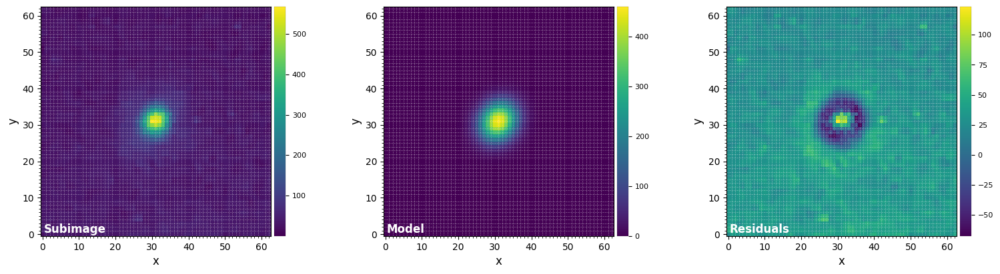

FWHM_y = 9.156646887045698
FWHM_x = 7.856504139141013 

centroid y = 31.001823026263057
centroid x = 30.915175663189462
centroid y subim = 31.001823026263057
centroid x subim = 30.915175663189462 

amplitude = 459.75779661472023
theta = -34.485425056680725


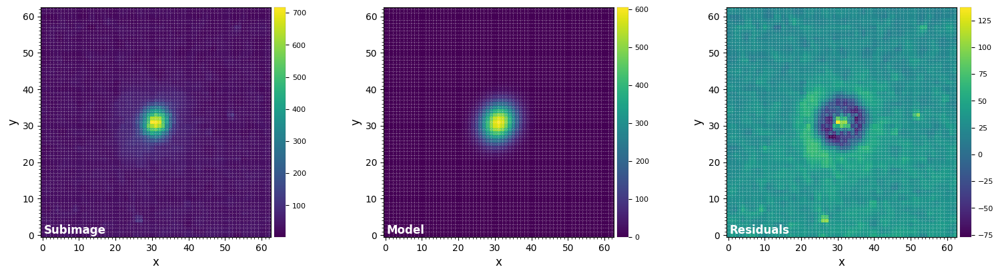

FWHM_y = 8.56468240997769
FWHM_x = 7.420111490416981 

centroid y = 30.892512103137754
centroid x = 30.93198278725038
centroid y subim = 30.892512103137754
centroid x subim = 30.93198278725038 

amplitude = 605.4711184368165
theta = -28.64888942230595


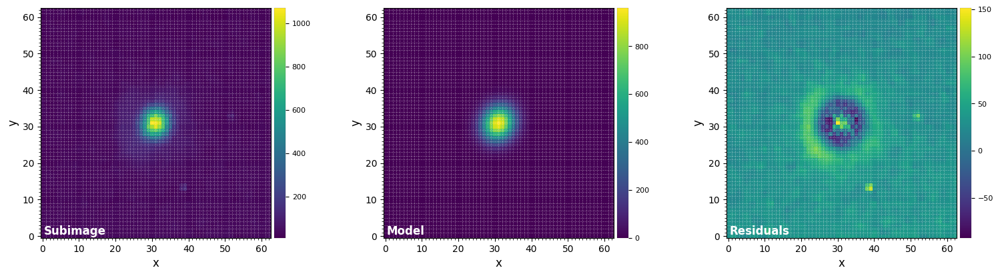

FWHM_y = 7.949272699339593
FWHM_x = 7.014450447526234 

centroid y = 30.949271612641574
centroid x = 30.90699787399855
centroid y subim = 30.949271612641574
centroid x subim = 30.90699787399855 

amplitude = 960.943881320361
theta = -26.70310216306601


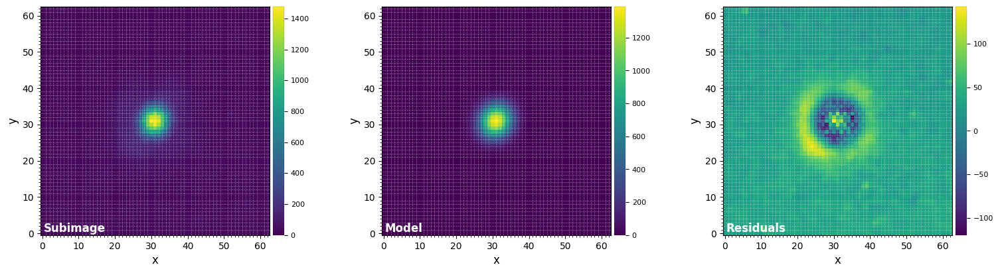

FWHM_y = 7.650702045204526
FWHM_x = 6.9053810808255625 

centroid y = 30.965471691771622
centroid x = 30.854268786645314
centroid y subim = 30.965471691771622
centroid x subim = 30.854268786645314 

amplitude = 1390.5000216860035
theta = -26.90095822639277


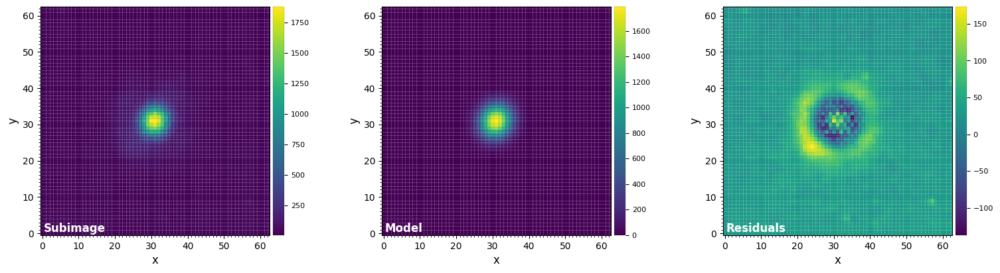

FWHM_y = 7.567886165201182
FWHM_x = 6.829506543268396 

centroid y = 30.953801805483394
centroid x = 30.850735325670296
centroid y subim = 30.953801805483394
centroid x subim = 30.850735325670296 

amplitude = 1793.7823235838696
theta = -26.511325790842474


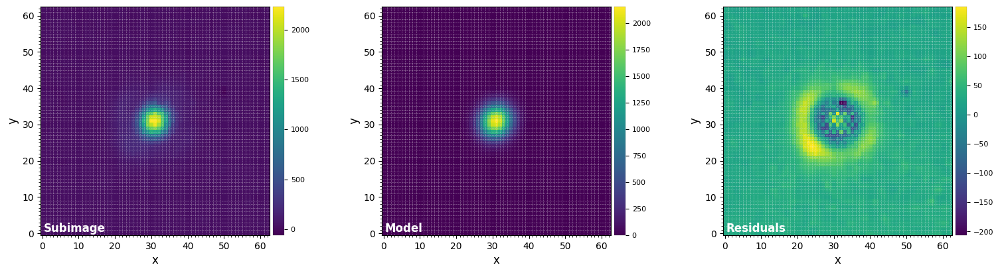

FWHM_y = 7.43852360075328
FWHM_x = 6.806495096649304 

centroid y = 30.94904651581271
centroid x = 30.845698674345496
centroid y subim = 30.94904651581271
centroid x subim = 30.845698674345496 

amplitude = 2159.7993949033576
theta = -27.72130437189739


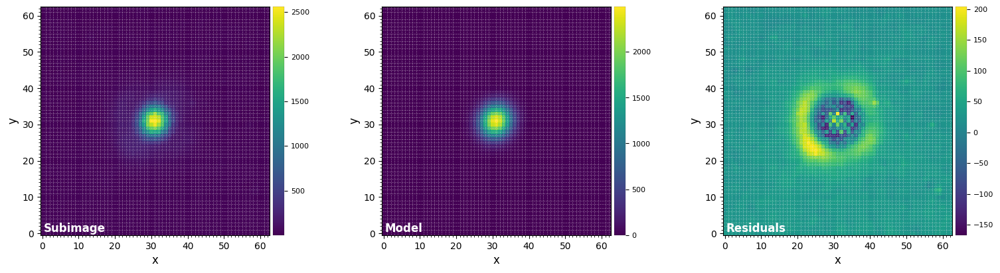

FWHM_y = 7.468282536441321
FWHM_x = 6.808380071664125 

centroid y = 30.98045409768399
centroid x = 30.848511644465116
centroid y subim = 30.98045409768399
centroid x subim = 30.848511644465116 

amplitude = 2497.7802012260445
theta = -25.60577196726101


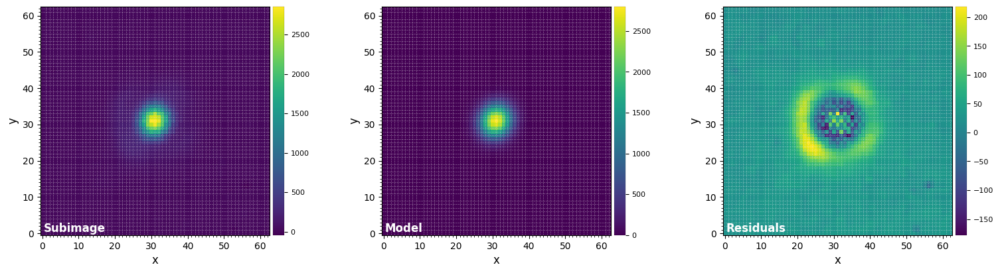

FWHM_y = 7.505960004576651
FWHM_x = 6.775464152068395 

centroid y = 31.02157397700544
centroid x = 30.84348143941966
centroid y subim = 31.02157397700544
centroid x subim = 30.84348143941966 

amplitude = 2804.645814735582
theta = -26.61266003542579


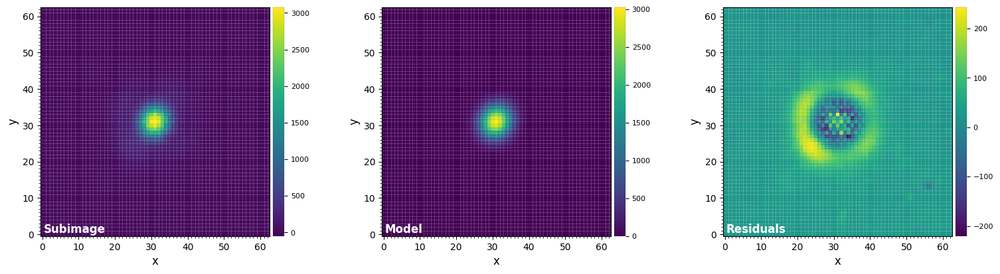

FWHM_y = 7.511207744205651
FWHM_x = 6.7631075389063735 

centroid y = 31.04349661448243
centroid x = 30.852008298436324
centroid y subim = 31.04349661448243
centroid x subim = 30.852008298436324 

amplitude = 3029.5828242931907
theta = -28.018501032134502


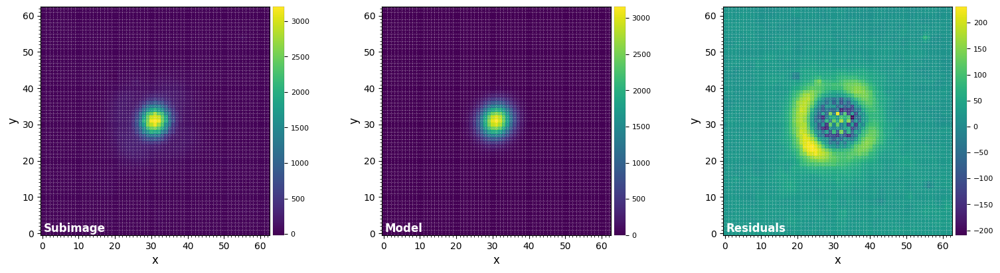

FWHM_y = 7.499791873543466
FWHM_x = 6.797190242078199 

centroid y = 31.04523226048288
centroid x = 30.87714107847504
centroid y subim = 31.04523226048288
centroid x subim = 30.87714107847504 

amplitude = 3162.490590283623
theta = -28.196420322229063


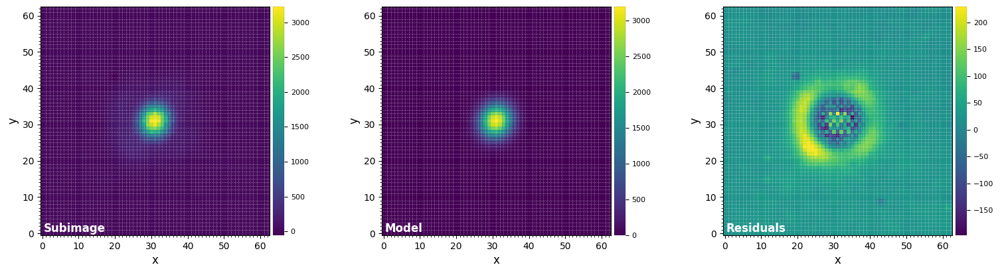

FWHM_y = 7.540259900889712
FWHM_x = 6.858114402847868 

centroid y = 31.036433537745893
centroid x = 30.87705119899833
centroid y subim = 31.036433537745893
centroid x subim = 30.87705119899833 

amplitude = 3195.8613640618955
theta = -25.363780719408645


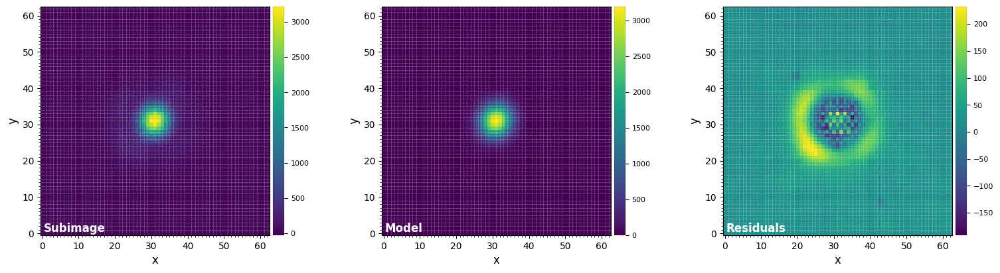

FWHM_y = 7.55313845200411
FWHM_x = 6.903049955513762 

centroid y = 31.037029954199777
centroid x = 30.881488260715322
centroid y subim = 31.037029954199777
centroid x subim = 30.881488260715322 

amplitude = 3196.2567247052675
theta = -24.535190700993205


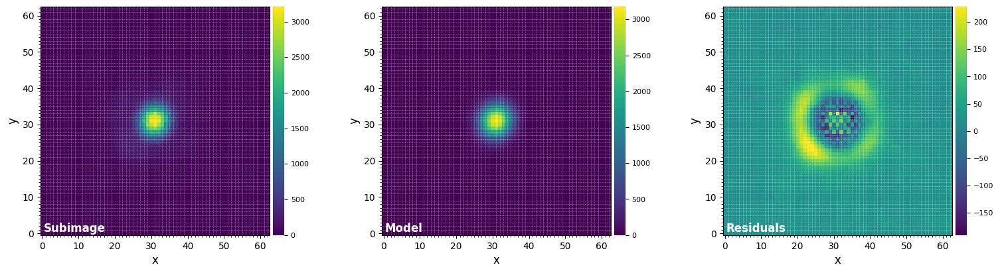

FWHM_y = 7.589195130554956
FWHM_x = 6.943286781092649 

centroid y = 31.02568400360554
centroid x = 30.87979124786396
centroid y subim = 31.02568400360554
centroid x subim = 30.87979124786396 

amplitude = 3182.476071003027
theta = -24.609538105977634


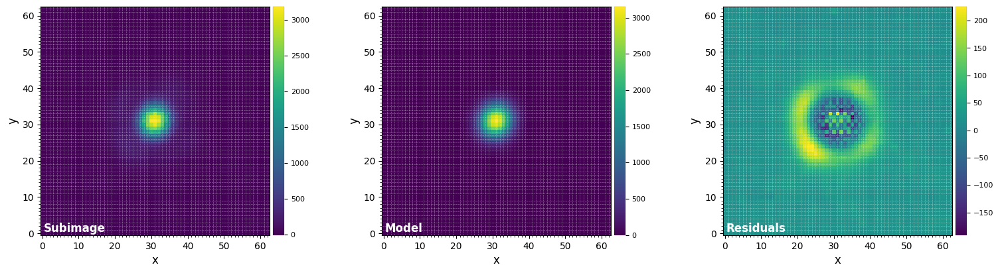

FWHM_y = 7.602469268870996
FWHM_x = 6.964318319697908 

centroid y = 31.037937824862844
centroid x = 30.884872100422463
centroid y subim = 31.037937824862844
centroid x subim = 30.884872100422463 

amplitude = 3155.05128030807
theta = -25.234910435635136


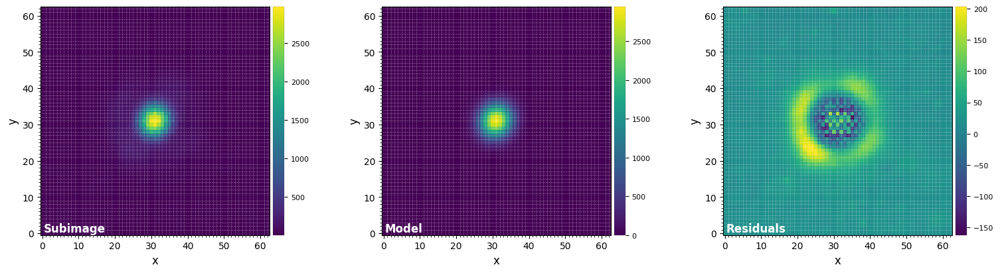

FWHM_y = 7.64212922302329
FWHM_x = 6.984688034502919 

centroid y = 31.062025241753407
centroid x = 30.886085484131375
centroid y subim = 31.062025241753407
centroid x subim = 30.886085484131375 

amplitude = 2950.739171324204
theta = -26.349338754359078


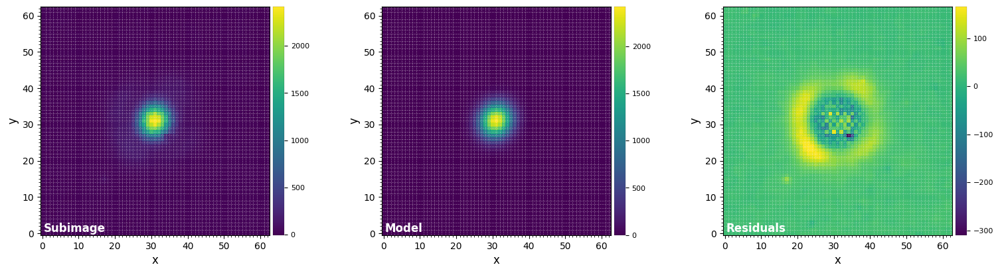

FWHM_y = 7.766008184258427
FWHM_x = 7.000945975012462 

centroid y = 31.119875417482618
centroid x = 30.872987587860635
centroid y subim = 31.119875417482618
centroid x subim = 30.872987587860635 

amplitude = 2423.43033584549
theta = -27.84308327848895
Mean FWHM per channel: 
[6.814 6.624 6.61  6.588 6.611 6.619 6.63  6.694 6.722 6.804 6.911 6.9
 6.823 6.86  6.865 6.884 6.845 6.879 6.91  6.892 6.962 7.188 7.756 8.507
 7.992 7.482 7.278 7.199 7.123 7.138 7.141 7.137 7.148 7.199 7.228 7.266
 7.283 7.313 7.383]
Flux in 1xFWHM aperture: 
[13743.933 19834.356 24188.692 26525.118 28044.64  31083.11  34274.876
 37424.896 36795.03  33932.841 34363.444 38970.389 43657.473 47725.216
 50906.898 53955.415 55903.676 59429.033 63314.732 63350.851 56413.045
 41087.439 25021.913 18939.357 21969.086 30570.44  42035.446 53024.058
 62507.509 72534.545 81440.442 87866.391 92035.156 94283.58  95012.993
 95576.18  95173.468 89706.19  75183.231]


In [17]:
%matplotlib inline
psfn, flux_st, fwhm = normalize_psf(psf[:,0], fwhm='fit', full_output=True, debug=True)

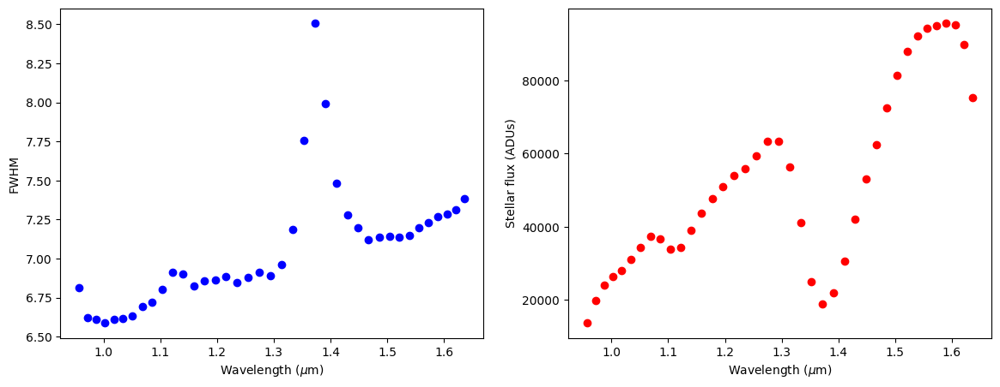

In [18]:
fig, axes = plt.subplots(1,2, figsize = (14,5))
ax1, ax2 = axes
ax1.plot(lbda, fwhm, 'bo')
ax1.set_xlabel(r"Wavelength ($\mu$m)")
ax1.set_ylabel("FWHM")
ax2.plot(lbda, flux_st, 'ro')
ax2.set_xlabel(r"Wavelength ($\mu$m)")
ax2.set_ylabel("Stellar flux (ADUs)")
plt.show()

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time]   (flux)
:Cube_shape	[63, 63, 39]


:DynamicMap   [time]
   :Image   [x,y]   (flux)
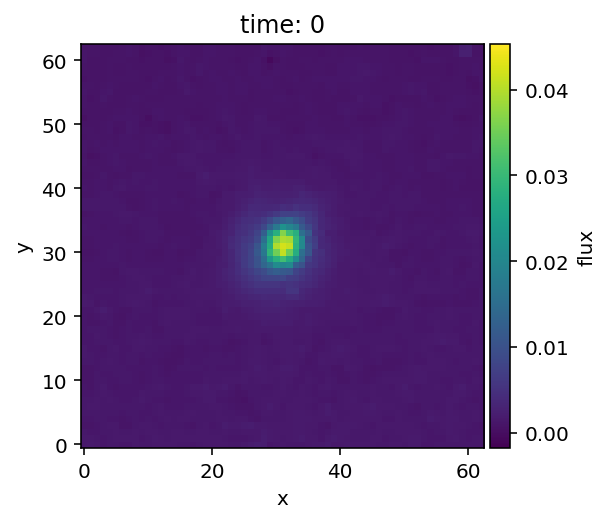

In [19]:
plot_cubes(psfn, grid=True)

## Post-processing of IFS data

### Optimal scaling factor

In [20]:
th_scal = lbda[-1]/lbda
th_scal

array([1.7083944, 1.6831094, 1.6576661, 1.6321594, 1.6066693, 1.5812904,
       1.5560788, 1.5311139, 1.5064236, 1.4820738, 1.4581087, 1.4345539,
       1.4114556, 1.38883  , 1.3667127, 1.3451117, 1.3240438, 1.3035111,
       1.2835453, 1.2641329, 1.2452896, 1.2270088, 1.2092929, 1.1921507,
       1.1755639, 1.1595472, 1.1440812, 1.1291704, 1.1148103, 1.1009887,
       1.087701 , 1.0749491, 1.0627136, 1.0510033, 1.0397995, 1.0291036,
       1.0189114, 1.0092114, 1.       ], dtype=float32)

In [21]:
mask = np.ones_like(cube[0,0])
mask = mask_circle(mask, int(0.16/plsc))

opt_scal_mean, opt_flux = find_scal_vector(np.mean(cube,axis=1), lbda, flux_st,
                                           mask=mask, nfp=2, fm="stddev")

In [22]:
opt_scals = np.zeros([cube.shape[1],cube.shape[0]])
opt_fluxes = np.zeros([cube.shape[1],cube.shape[0]])
for i in range(cube.shape[1]):
    opt_scals[i], opt_fluxes[i] = find_scal_vector(cube[:,i], lbda, flux_st, mask=mask, nfp=2, fm="stddev")

In [23]:
opt_scal_med = np.median(opt_scals,axis=0)
opt_flux_med = np.median(opt_fluxes,axis=0)

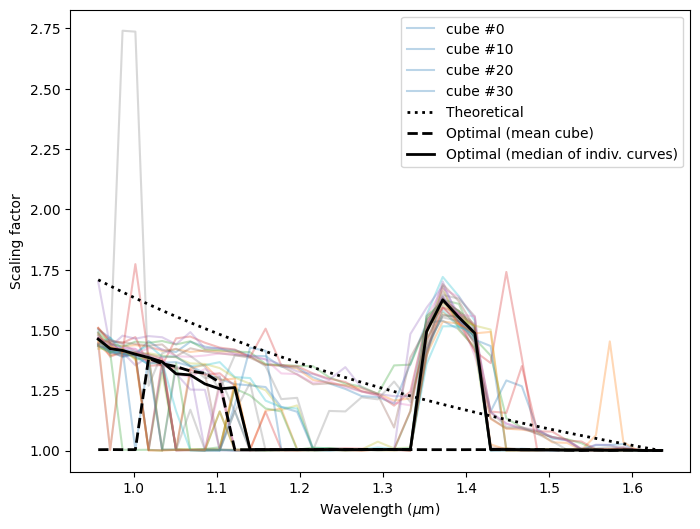

In [24]:
%matplotlib inline
plt.figure(figsize=(8,6))
for i in range(cube.shape[1]):
    if not i%10:
        label = 'cube #{}'.format(i)
    else:
        label = None
    plt.plot(lbda, opt_scals[i], alpha=0.3, label=label)
plt.plot(lbda, th_scal, 'k:', lw=2, label='Theoretical')
plt.plot(lbda, opt_scal_mean, 'k--', lw=2, label='Optimal (mean cube)')
plt.plot(lbda, np.median(opt_scals,axis=0), 'k-', lw=2, label='Optimal (median of indiv. curves)')
plt.xlabel(r"Wavelength ($\mu$m)")
plt.ylabel("Scaling factor")
plt.legend()

In [25]:
res_cube_test_opt = np.zeros([cube.shape[0],cube.shape[-2],cube.shape[-1]])
for i in range(cube.shape[0]):
    res_cube_test_opt[i] = opt_fluxes[0,i]*frame_rescaling(cube[i,0], scale=opt_scal_med[i])-cube[-1,0]

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time]   (flux)
:Cube_shape	[290, 290, 39]


:DynamicMap   [time]
   :Image   [x,y]   (flux)
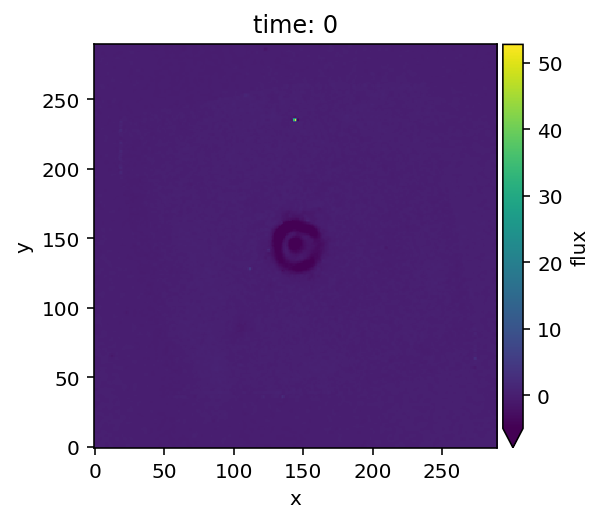

In [26]:
plot_cubes(res_cube_test_opt, vmin=-5)

### median-SDI

In [27]:
mask_px = int(0.1/plsc)

med_SDI = median_sub(cube, derot_angles, scale_list=opt_scal_med, sdi_only=True,
                     radius_int=mask_px, interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-09 13:38:41
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
39 spectral channels per IFS frame
First median subtraction exploiting spectral variability
Running time:  0:03:03.731831
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
32 ADI frames
Median subtraction in the ADI fashion
Done derotating and combining
Running time:  0:03:20.531277
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


In [28]:
med_SDI_opt = median_sub(cube, derot_angles, scale_list=opt_scal_med, flux_sc_list=opt_flux_med, sdi_only=True,
                         radius_int=mask_px, interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-09 13:42:02
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
39 spectral channels per IFS frame
First median subtraction exploiting spectral variability
Running time:  0:02:58.713398
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
32 ADI frames
Median subtraction in the ADI fashion
Done derotating and combining
Running time:  0:03:15.349084
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


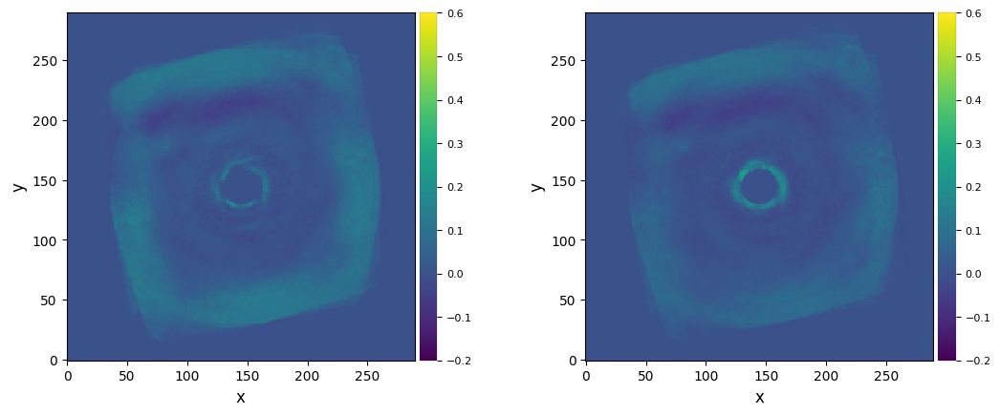

In [29]:
%matplotlib inline
plot_frames((med_SDI, med_SDI_opt), vmin=-0.2, vmax=0.6)

### PCA-SDI

#### Full-frame PCA

In [30]:
ncomp_sdi = 1
mask_px = int(0.1/plsc)

pca_sdi = pca(cube, derot_angles, scale_list=opt_scal_med, ncomp=(ncomp_sdi,None),
              adimsdi='double', crop_ifs=False, imlib='opencv',
              interp_zeros=True, mask_val=0, mask_center_px=mask_px)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-09 13:45:17
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 134.824 GB
System available memory = 118.138 GB
39 spectral channels in IFS cube
First PCA stage exploiting spectral variability
Running time:  0:02:42.237176
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
32 ADI frames
De-rotating and combining frames (skipping PCA)
Running time:  0:02:42.486061
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


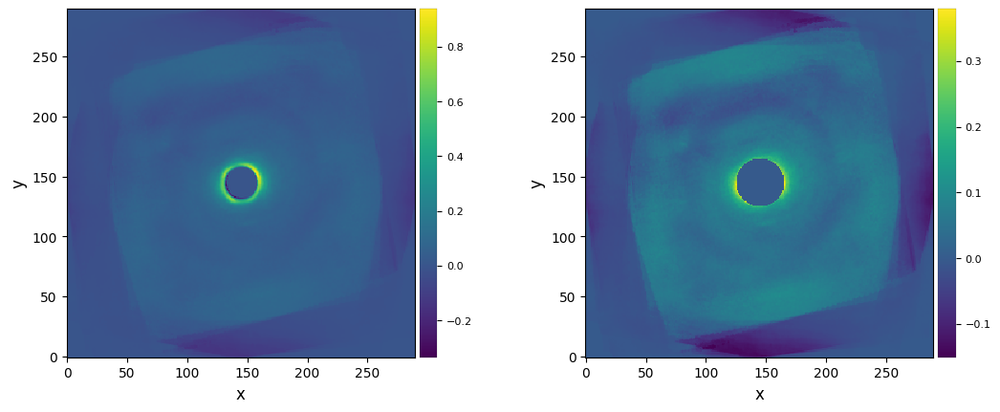

In [31]:
%matplotlib inline
plot_frames((pca_sdi, mask_circle(pca_sdi,20)))

#### Annular PCA

In [32]:
ncomp_sdi = 1
mask_px = int(0.1/plsc)
fwhm_m = np.mean(fwhm)

pca_sdi_ann = pca_annular(cube, derot_angles, scale_list=opt_scal_med,
                          ncomp=(ncomp_sdi,None), radius_int=mask_px, fwhm=fwhm_m, asize=fwhm_m,
                          delta_sep=(0.4, 1), delta_rot=(0.5, 1),
                          mask_val=0, interp_zeros=True)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-09 13:48:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
First PCA subtraction exploiting the spectral variability
39 spectral channels per IFS frame
N annuli = 18, mean FWHM = 7.000
Running time:  0:06:23.676674
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
32 ADI frames
Skipping the second PCA subtraction


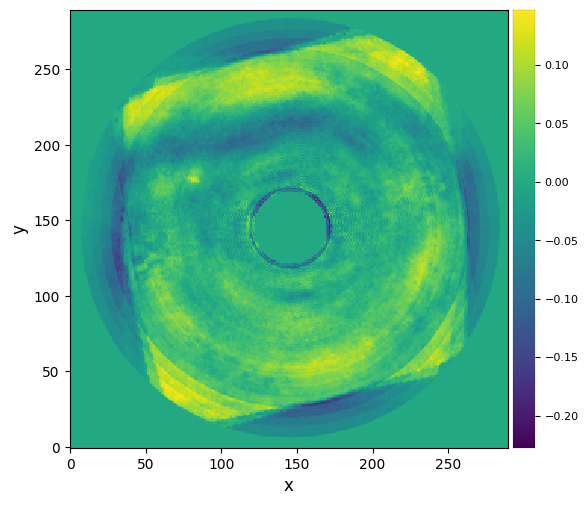

In [33]:
plot_frames(mask_circle(pca_sdi_ann, int(0.18/plsc)))

### median-ASDI

In [34]:
mask_px = int(0.1/plsc)

med_ASDI = median_sub(cube, derot_angles, scale_list=opt_scal_med, flux_sc_list=opt_flux_med,
                      radius_int=mask_px, interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-09 13:54:41
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
39 spectral channels per IFS frame
First median subtraction exploiting spectral variability
Running time:  0:03:04.394441
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
32 ADI frames
Median subtraction in the ADI fashion
Done derotating and combining
Running time:  0:03:20.960452
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


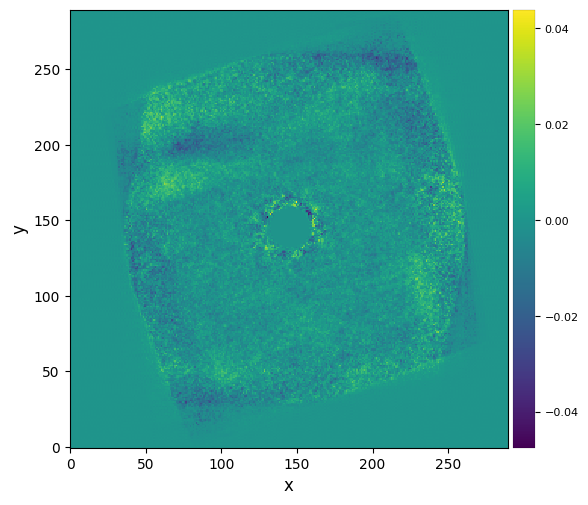

In [35]:
%matplotlib inline
plot_frames(med_ASDI)

### PCA-ASDI

#### Full-frame PCA-ASDI (single step)

In [36]:
ncomp = 6
pca_asdi = pca(cube, derot_angles, scale_list=opt_scal_med, ncomp=ncomp,
                adimsdi='single', crop_ifs=False, mask_center_px=mask_px,
                interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-09 13:58:03
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 134.824 GB
System available memory = 119.103 GB
Rescaling the spectral channels to align the speckles
Running time:  0:01:33.001073
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
1248 total frames
Performing single-pass PCA
Done vectorizing the frames. Matrix shape: (1248, 222784)
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:03:41.021207
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Descaling the spectral channels
De-rotating and combining residuals
Running time:  0:04:39.046334
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


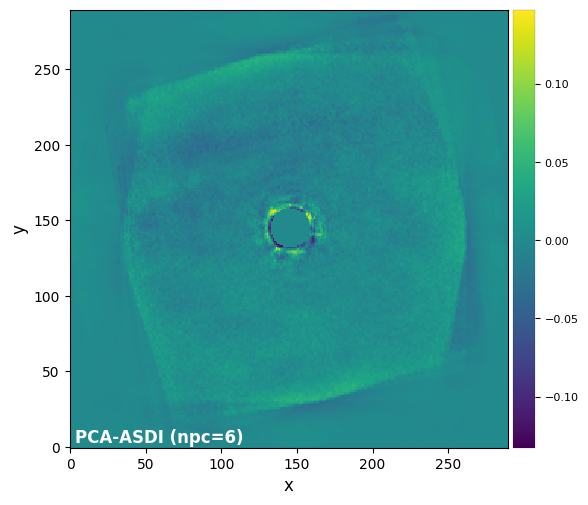

In [37]:
plot_frames(pca_asdi, label='PCA-ASDI (npc={:.0f})'.format(ncomp),
            dpi=100, colorbar=True)

#### Full-frame PCA-ASDI (double step)

In [38]:
ncomp = (1,1)
pca_asdi_2s = pca(cube, derot_angles, scale_list=opt_scal_med, ncomp=ncomp,
                adimsdi='double', crop_ifs=False, mask_center_px=mask_px,
                interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-09 14:02:59
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 134.824 GB
System available memory = 118.861 GB
39 spectral channels in IFS cube
First PCA stage exploiting spectral variability
Running time:  0:02:46.297261
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
32 ADI frames
Second PCA stage exploiting rotational variability
De-rotating and combining residuals
Running time:  0:03:02.549191
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


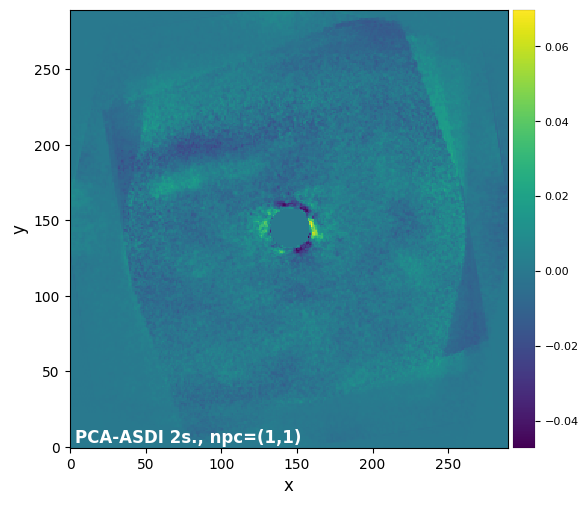

In [39]:
plot_frames(pca_asdi_2s,
            label='PCA-ASDI 2s., npc=({:.0f},{})'.format(ncomp[0],ncomp[1]),
            dpi=100, colorbar=True)

#### Annular PCA-ASDI (double step)

In [40]:
ncomp = (1,1)
pca_ann = pca_annular(cube, derot_angles, scale_list=opt_scal_med, ncomp=ncomp,
                      radius_int=mask_px, fwhm=np.mean(fwhm), asize=np.mean(fwhm),
                      mask_val=0, interp_zeros=True)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-09 14:06:02
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
First PCA subtraction exploiting the spectral variability
39 spectral channels per IFS frame
N annuli = 18, mean FWHM = 7.000
Running time:  0:06:12.758204
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
32 ADI frames
Second PCA subtraction exploiting the angular variability
N annuli = 18, FWHM = 7.000
PCA per annulus (or annular sectors):
Ann 1    PA thresh:  2.43    Ann center:  17    N segments: 1 
Done PCA with lapack for current annulus
Running time:  0:06:12.793110
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 2    PA thresh:  2.60    Ann center:  24    N segments: 1 
Done PCA with lapack for current annulus
Running time:  0:06:12.831294
―――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

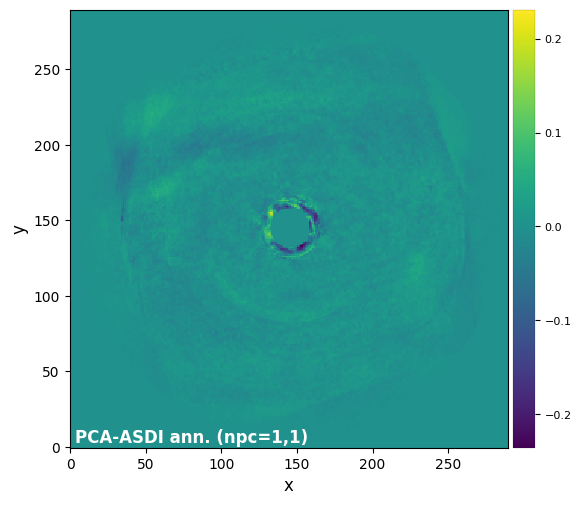

In [41]:
plot_frames(pca_ann, label='PCA-ASDI ann. (npc={:.0f},{:.0f})'.format(ncomp[0], ncomp[1]),
            dpi=100, colorbar=True)

### PCA-ADI for all spectral channels

In [42]:
mask_px = int(0.08/plsc)

In [43]:
ncomp_ff = 6
pca_adi_mean = pca(cube, derot_angles, ncomp=ncomp_ff, adimsdi='single', mask_center_px=mask_px,
                   interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-09 14:12:41
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 134.824 GB
System available memory = 118.899 GB
Done vectorizing the frames. Matrix shape: (32, 84100)
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.140181
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done de-rotating and combining
Running time:  0:00:17.279772
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done vectorizing the frames. Matrix shape: (32, 84100)
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:17.409516
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done de-rotating and combining
Running time:  0:00:34.226274
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done vectorizing the frames. Matrix shape: 

In [44]:
ncomp_ann = 4
pca_adi_ann_mean = pca_annular(cube, derot_angles, ncomp=ncomp_ann, radius_int=mask_px,
                               fwhm=np.mean(fwhm), asize=2*np.mean(fwhm), delta_rot=(0.2,1),
                               mask_val=0, interp_zeros=True)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-09 14:23:38
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
N annuli = 9, FWHM = 7.057
PCA per annulus (or annular sectors):
Ann 1    PA thresh:  4.74    Ann center:  17    N segments: 1 
Done PCA with lapack for current annulus
Running time:  0:00:00.044578
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 2    PA thresh:  3.89    Ann center:  31    N segments: 1 
Done PCA with lapack for current annulus
Running time:  0:00:00.435223
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 3    PA thresh:  3.57    Ann center:  45    N segments: 1 
Done PCA with lapack for current annulus
Running time:  0:00:01.565824
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 4    PA thresh:  3.40    Ann center:  59    N segments: 1 
Done PCA with lapack for curre

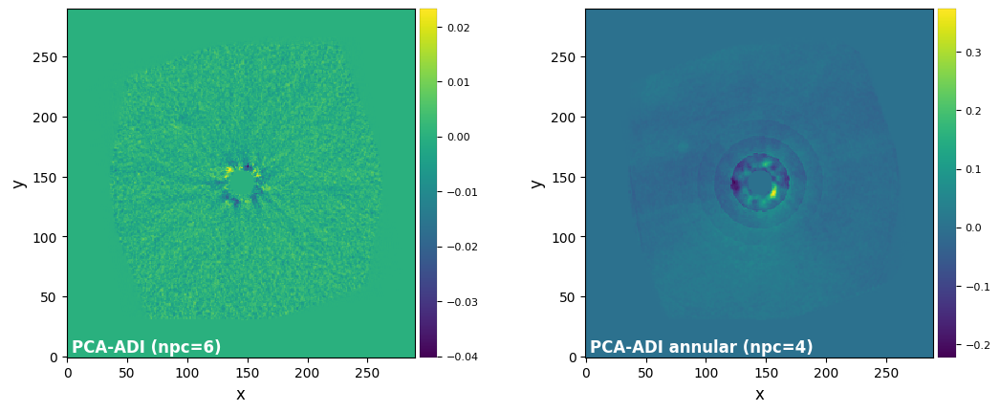

In [45]:
plot_frames((pca_adi_mean, pca_adi_ann_mean),
            label=('PCA-ADI (npc={:.0f})'.format(ncomp_ff),
                   'PCA-ADI annular (npc={:.0f})'.format(ncomp_ann)),
            dpi=100, colorbar=True)